In [8]:
import gradio as gr
import numpy as np
import IPython
from IPython.display import Audio, display
import torch
import librosa, librosa.display
from tqdm import tqdm
import json

# import sys  
# sys.path.insert(0, '../')
from audioldm2 import text_to_audio, build_model, seed_everything, make_batch_for_text_to_audio
from audioldm2.latent_diffusion.modules.diffusionmodules.util import (
    make_ddim_sampling_parameters,
    make_ddim_timesteps,
    noise_like,
    extract_into_tensor,
)
from audioldm2.latent_diffusion.models.ddim import DDIMSampler
from audioldm2.utilities import *
from audioldm2.utilities.audio import *
from audioldm2.utilities.data import *
from audioldm2.utils import default_audioldm_config

from audioldm2.gaverutils import gaver_sounds

%matplotlib inline
import matplotlib.pyplot as plt

In [9]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [10]:
%reload_ext autoreload

In [11]:
%matplotlib inline

In [12]:
import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()


In [13]:
audioldm = None
current_model_name = None

model_name = 'audioldm_16k_crossattn_t5' # doesnt work very well? But the only thing that fits on my machine
# model_name = 'audioldm2-full' # Needs more memory than what I have
# model_name = 'audioldm_48k'

latent_diffusion=build_model(model_name=model_name)

Loading AudioLDM-2: audioldm_16k_crossattn_t5
Loading model on cuda:0
{'variables': {'sampling_rate': 16000, 'mel_bins': 64, 'latent_embed_dim': 8, 'latent_t_size': 256, 'latent_f_size': 16, 'in_channels': 8, 'optimize_ddpm_parameter': True, 'warmup_steps': 5000}, 'step': {'validation_every_n_epochs': 1, 'save_checkpoint_every_n_steps': 5000, 'max_steps': 1500000, 'save_top_k': 2}, 'preprocessing': {'audio': {'sampling_rate': 16000, 'max_wav_value': 32768, 'duration': 10.24}, 'stft': {'filter_length': 1024, 'hop_length': 160, 'win_length': 1024}, 'mel': {'n_mel_channels': 64, 'mel_fmin': 0, 'mel_fmax': 8000}}, 'augmentation': {'mixup': 0}, 'model': {'target': 'audioldm2.latent_diffusion.models.ddpm.LatentDiffusion', 'params': {'first_stage_config': {'base_learning_rate': 8e-06, 'target': 'audioldm2.latent_encoder.autoencoder.AutoencoderKL', 'params': {'sampling_rate': 16000, 'batchsize': 4, 'monitor': 'val/rec_loss', 'image_key': 'fbank', 'subband': 1, 'embed_dim': 8, 'time_shuffle': 1

/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torchaudio/transforms/_transforms.py:580: UserWarning: Argument 'onesided' has been deprecated and has no influence on the behavior of this module.
  warnings.warn(


DiffusionWrapper has 265.53 M params.


/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/nn/utils/weight_norm.py:28: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")


In [14]:
def noise_to_mel_to_wave(predicted_noise):
    mel = latent_diffusion.decode_first_stage(predicted_noise)
    waveform = latent_diffusion.mel_spectrogram_to_waveform(
        mel, savepath="", bs=None, name="somename", save=False
    )
    return waveform

In [15]:
plt.close()

In [16]:
latent_t_per_second=25.6
sample_rate=16000
duration = 10.0 #Duration is minimum 10 secs. The generated sounds are weird for <10secs
guidance_scale = 3
random_seed = 1943
n_candidates = 1
batch_size = 1
ddim_steps = 20

fbank = torch.zeros((batch_size, 1024, 64))
stft = torch.zeros((batch_size, 1024, 512))
waveform = torch.zeros((batch_size, 160000))

seed_everything(int(random_seed))
x_init = torch.randn((1, 8, 256, 16), device="cuda")

latent_diffusion.latent_t_size = int(duration * latent_t_per_second)

In [17]:
def plot(waveform, predicted_noise, predicted_uncond_noise):
    epsilon_noise = noise_to_mel_to_wave(predicted_noise)
    epsilon_noise_uncond = noise_to_mel_to_wave(predicted_uncond_noise)
    
    IPython.display.display(IPython.display.Audio(waveform[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise_uncond[0][0], rate=16000))
    
    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(waveform[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise_uncond[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[2])
    
    torch.norm(predicted_noise), torch.norm(predicted_uncond_noise)

def plot_wavs(wav1, wav2):
    IPython.display.display(IPython.display.Audio(wav1[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(wav2[0][0], rate=16000))

    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav1[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    axs[0].set_title('wav1') 
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav2[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    axs[1].set_title('wav2') 

def plot_all(wavs):
    %matplotlib inline
    nrows = len(wavs)//4 
    if len(wavs)%4 > 0:
        nrows += 1
    print('num rows=', nrows)
    fig, axs = plt.subplots(nrows=nrows, ncols=4, figsize=(15,5))
    for i, wav in enumerate(wavs):
        nrow = i//4
        ncol = i%4
        IPython.display.display(IPython.display.Audio(wav[0][0], rate=16000))

        D = librosa.amplitude_to_db(np.abs(librosa.stft(wav[0][0], hop_length=512)),ref=np.max)
        if nrows>1:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[nrow][ncol])
        else:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[ncol])

In [18]:
def sample_diffusion(batch, x_init, random_seed=45):
    with torch.no_grad():
        seed_everything(int(random_seed))
        if x_init is None:
            print('x_init-ing')
            x_init = torch.randn((1, 8, 256, 16), device="cuda")

        
        text_conditioning = batch["text"]

        # The logic behind creating this "conditioning dict" is a little convoluted. 
        # We are able to use only text for conditioning, but for some reason the system expects other MAE related values to be
        # set on the dict. Anyways... junk code - but works. 
        cond_batch = make_batch_for_text_to_audio(text_conditioning[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        uncond_dict = {}
        for key in latent_diffusion.cond_stage_model_metadata:
            model_idx = latent_diffusion.cond_stage_model_metadata[key]["model_idx"]
            uncond_dict[key] = latent_diffusion.cond_stage_models[
                model_idx
            ].get_unconditional_condition(batch_size)
        

        shape = (latent_diffusion.channels, latent_diffusion.latent_t_size, latent_diffusion.latent_f_size)
        device=latent_diffusion.device
        eta=1.0
        temperature = 1.0
        noise = noise_like(x_init.shape, device, repeat=False) * temperature

        ddim_sampler = DDIMSampler(latent_diffusion, device=device)
        ddim_sampler.make_schedule(ddim_num_steps=ddim_steps, ddim_eta=eta, verbose=False)
        
        timesteps = ddim_sampler.ddim_timesteps

        intermediates = {"x_prev": [x_init], "predicted_noise_orig": [x_init], "predicted_noise_sega": [x_init]}
        time_range = np.flip(timesteps)
        total_steps = timesteps.shape[0]
        print(f"Running DDIM Sampling with {total_steps} timesteps")
        iterator = tqdm(time_range, desc="DDIM Sampler", total=total_steps)
    
        for i, step in enumerate(iterator):
            index = total_steps - i - 1
            t_in = torch.full((batch_size,), step, device=device, dtype=torch.long)
    
            #from p_sample_ddim
            model_uncond = ddim_sampler.model.apply_model(x_init, t_in, uncond_dict) #Unconditioned epsilon estimate
            model_cond = ddim_sampler.model.apply_model(x_init, t_in, cond_dict) #Conditioned epsilon estimate


            
            # CFG; model_output is the estimated error after CFG
            e_t = model_cond + guidance_scale * (model_cond - model_uncond)

        
            alphas = ddim_sampler.ddim_alphas
            alphas_prev = ddim_sampler.ddim_alphas_prev
    
            sqrt_one_minus_alphas = ddim_sampler.ddim_sqrt_one_minus_alphas
            sigmas = ddim_sampler.ddim_sigmas
            
            # select parameters corresponding to the currently considered timestep
            a_t = torch.full((batch_size, 1, 1, 1), alphas[index], device=device)
            a_prev = torch.full((batch_size, 1, 1, 1), alphas_prev[index], device=device)
            sigma_t = torch.full((batch_size, 1, 1, 1), sigmas[index], device=device)
            sqrt_one_minus_at = torch.full((batch_size, 1, 1, 1), sqrt_one_minus_alphas[index], device=device)
    
            noise = sigma_t * noise_like(x_init.shape, device, repeat=False) * temperature
            
            pred_x0 = (x_init - sqrt_one_minus_at * e_t) / a_t.sqrt()
            dir_xt = (1.0 - a_prev - sigma_t**2).sqrt() * e_t
            x_prev = a_prev.sqrt() * pred_x0 + dir_xt + noise
            
    
            x_init = x_prev
            #return x_prev, pred_x0, e_t, model_uncond => img, pred_x0, predicted_noise, predicted_uncond_noise
    
            log_every_t = 1
            if index % log_every_t == 0 or index == total_steps - 1:
                intermediates["x_prev"].append(x_prev)
                intermediates["predicted_noise_orig"].append(e_t)
    
        mel = latent_diffusion.decode_first_stage(x_prev)
        waveform = latent_diffusion.mel_spectrogram_to_waveform(
            mel, savepath="", bs=None, name="", save=False
        )
        return mel, waveform, model_cond, model_uncond, e_t, intermediates 
        #=> mel of estimated z; wav of estimated z; predicted noise (epsilon); predicted noise unconditional; predicted noise with CFG

In [19]:
def sample_diffusion_with_exampleguidance(batch, x_init, x_example, semantic_guidance_level=10.0, random_seed=45, use_orig=False):
    with torch.no_grad():
        seed_everything(int(random_seed))
        if x_init is None:
            print('x_init-ing')
            x_init = torch.randn((1, 8, 256, 16), device="cuda")

        
        text_conditioning = batch["text"]
        semantic_edit_conditioning = batch["semantic_edit_text"]
        
        # The logic behind creating this "conditioning dict" is a little convoluted. 
        # We are able to use only text for conditioning, but for some reason the system expects other MAE related values to be
        # set on the dict. Anyways... junk code - but works. 
        cond_batch = make_batch_for_text_to_audio(text_conditioning[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        uncond_dict = {}
        for key in latent_diffusion.cond_stage_model_metadata:
            model_idx = latent_diffusion.cond_stage_model_metadata[key]["model_idx"]
            uncond_dict[key] = latent_diffusion.cond_stage_models[
                model_idx
            ].get_unconditional_condition(batch_size)

        semantic_cond_batch = make_batch_for_text_to_audio(semantic_edit_conditioning[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(semantic_cond_batch, latent_diffusion.first_stage_key, unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        semantic_cond_dict = latent_diffusion.filter_useful_cond_dict(c)
        

        shape = (latent_diffusion.channels, latent_diffusion.latent_t_size, latent_diffusion.latent_f_size)
        device=latent_diffusion.device
        eta=1.0
        temperature = 1.0
        noise = noise_like(x_init.shape, device, repeat=False) * temperature

        ddim_sampler = DDIMSampler(latent_diffusion, device=device)
        ddim_sampler.make_schedule(ddim_num_steps=ddim_steps, ddim_eta=eta, verbose=False)
        
        timesteps = ddim_sampler.ddim_timesteps

        intermediates = {"x_prev": [x_init], "predicted_noise_orig": [x_init], "predicted_noise_sega": [x_init]}
        time_range = np.flip(timesteps)
        total_steps = timesteps.shape[0]
        print(f"Running DDIM Sampling with {total_steps} timesteps")
        iterator = tqdm(time_range, desc="DDIM Sampler", total=total_steps)
    
        for i, step in enumerate(iterator):
            index = total_steps - i - 1
            t_in = torch.full((batch_size,), step, device=device, dtype=torch.long)
    
            #from p_sample_ddim
            model_uncond = ddim_sampler.model.apply_model(x_init, t_in, uncond_dict) #Unconditioned epsilon estimate
            model_cond = ddim_sampler.model.apply_model(x_init, t_in, cond_dict) #Conditioned epsilon estimate
            
            # CFG; model_output is the estimated error after CFG
            # e_t = model_uncond + guidance_scale * (model_cond - model_uncond)
            e_t = model_cond + guidance_scale * (model_cond - model_uncond)
            
            if np.abs(semantic_guidance_level) > 0.0:
                model_semantic_cond = ddim_sampler.model.apply_model(x_example, t_in, semantic_cond_dict) #Sem Guidance epsilon estimate
    
                #Sem guidance
                phi = model_semantic_cond - model_uncond
                if use_orig:
                    model_semantic_cond_q = torch.quantile(torch.abs(phi).flatten(start_dim=3), semantic_quantile, dim=3, keepdim=False) 
                    model_semantic_cond_edited = torch.where(
                                    torch.abs(phi) >= model_semantic_cond_q[:, :, :, None],
                                    phi,
                                    torch.zeros_like(phi),
                                )
                    # print(model_semantic_cond_edited, phi.shape, model_semantic_cond_edited.shape)
    
                    # semantic_edit_level = 1 #??
                    # model_semantic_cond_edited = torch.where(
                    #                 torch.abs(model_semantic_cond_edited) >= semantic_edit_level,
                    #                 model_semantic_cond_edited,
                    #                 torch.zeros_like(model_semantic_cond_edited))
    
                    model_semantic_cond_edited = model_semantic_cond_edited * semantic_guidance_level 
    
                else:
                    model_semantic_cond_edited = semantic_guidance_level
    
                # if i<=5:
                if i>=15:
                    e_t_semedit = e_t + (model_semantic_cond_edited * phi)
                else:
                    e_t_semedit = e_t
            else:
                e_t_semedit = e_t

            
        
            alphas = ddim_sampler.ddim_alphas
            alphas_prev = ddim_sampler.ddim_alphas_prev
    
            sqrt_one_minus_alphas = ddim_sampler.ddim_sqrt_one_minus_alphas
            sigmas = ddim_sampler.ddim_sigmas
            
            # select parameters corresponding to the currently considered timestep
            a_t = torch.full((batch_size, 1, 1, 1), alphas[index], device=device)
            a_prev = torch.full((batch_size, 1, 1, 1), alphas_prev[index], device=device)
            sigma_t = torch.full((batch_size, 1, 1, 1), sigmas[index], device=device)
            sqrt_one_minus_at = torch.full((batch_size, 1, 1, 1), sqrt_one_minus_alphas[index], device=device)
    
            noise = sigma_t * noise_like(x_init.shape, device, repeat=False) * temperature
            
            pred_x0 = (x_init - sqrt_one_minus_at * e_t_semedit) / a_t.sqrt()
            dir_xt = (1.0 - a_prev - sigma_t**2).sqrt() * e_t_semedit
            x_prev = a_prev.sqrt() * pred_x0 + dir_xt + noise
            
    
            x_init = x_prev
            #return x_prev, pred_x0, e_t, model_uncond => img, pred_x0, predicted_noise, predicted_uncond_noise
    
            log_every_t = 1
            if index % log_every_t == 0 or index == total_steps - 1:
                intermediates["x_prev"].append(x_prev)
                intermediates["predicted_noise_orig"].append(e_t_semedit)
    
        mel = latent_diffusion.decode_first_stage(x_prev)
        waveform = latent_diffusion.mel_spectrogram_to_waveform(
            mel, savepath="", bs=None, name="", save=False
        )
        return mel, waveform, model_cond, model_uncond, e_t_semedit, intermediates 
        #=> mel of estimated z; wav of estimated z; predicted noise (epsilon); predicted noise unconditional; predicted noise with CFG

In [41]:
def sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, semantic_guidance_level=10.0, random_seed=45, use_orig=False):
    with torch.no_grad():
        seed_everything(int(random_seed))
        if x_init is None:
            print('x_init-ing')
            x_init = torch.randn((1, 8, 256, 16), device="cuda")

        
        text_conditioning = batch["text"]
        semantic_edit_conditioning_left = batch["semantic_edit_text_left"]
        semantic_edit_conditioning_right = batch["semantic_edit_text_right"]
        
        # The logic behind creating this "conditioning dict" is a little convoluted. 
        # We are able to use only text for conditioning, but for some reason the system expects other MAE related values to be
        # set on the dict. Anyways... junk code - but works. 
        cond_batch = make_batch_for_text_to_audio(text_conditioning[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        uncond_dict = {}
        for key in latent_diffusion.cond_stage_model_metadata:
            model_idx = latent_diffusion.cond_stage_model_metadata[key]["model_idx"]
            uncond_dict[key] = latent_diffusion.cond_stage_models[
                model_idx
            ].get_unconditional_condition(batch_size)

        semantic_cond_batch_left = make_batch_for_text_to_audio(semantic_edit_conditioning_left[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(semantic_cond_batch_left, latent_diffusion.first_stage_key, unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        semantic_cond_dict_left = latent_diffusion.filter_useful_cond_dict(c)


        semantic_cond_batch_right = make_batch_for_text_to_audio(semantic_edit_conditioning_right[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(semantic_cond_batch_right, latent_diffusion.first_stage_key, unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        semantic_cond_dict_right = latent_diffusion.filter_useful_cond_dict(c)
        

        shape = (latent_diffusion.channels, latent_diffusion.latent_t_size, latent_diffusion.latent_f_size)
        device=latent_diffusion.device
        eta=1.0
        temperature = 1.0
        noise = noise_like(x_init.shape, device, repeat=False) * temperature

        ddim_sampler = DDIMSampler(latent_diffusion, device=device)
        ddim_sampler.make_schedule(ddim_num_steps=ddim_steps, ddim_eta=eta, verbose=False)
        
        timesteps = ddim_sampler.ddim_timesteps

        intermediates = {"x_prev": [x_init], "predicted_noise_orig": [x_init], "predicted_noise_sega": [x_init]}
        time_range = np.flip(timesteps)
        total_steps = timesteps.shape[0]
        print(f"Running DDIM Sampling with {total_steps} timesteps")
        iterator = tqdm(time_range, desc="DDIM Sampler", total=total_steps)
    
        for i, step in enumerate(iterator):
            index = total_steps - i - 1
            t_in = torch.full((batch_size,), step, device=device, dtype=torch.long)
    
            #from p_sample_ddim
            model_uncond = ddim_sampler.model.apply_model(x_init, t_in, uncond_dict) #Unconditioned epsilon estimate
            model_cond = ddim_sampler.model.apply_model(x_init, t_in, cond_dict) #Conditioned epsilon estimate
            
            # CFG; model_output is the estimated error after CFG
            # e_t = model_uncond + guidance_scale * (model_cond - model_uncond)
            e_t = model_cond + guidance_scale * (model_cond - model_uncond)
            
            if np.abs(semantic_guidance_level) > 0.0:

                model_semantic_cond_left = ddim_sampler.model.apply_model(x_example_left, t_in, semantic_cond_dict_left) #Sem Guidance epsilon estimate
                model_semantic_cond_right = ddim_sampler.model.apply_model(x_example_right, t_in, semantic_cond_dict_right) #Sem Guidance epsilon estimate


                semantic_epsilon = model_semantic_cond_left - model_semantic_cond_right
                semantic_epsilon = semantic_epsilon/torch.norm(semantic_epsilon)
    
                if i<=15:
                # if i>=15:
                    e_t_semedit = e_t + (semantic_guidance_level * semantic_epsilon)
                else:
                    e_t_semedit = e_t
            else:
                e_t_semedit = e_t

            # print(torch.max(e_t_semedit))
        
            alphas = ddim_sampler.ddim_alphas
            alphas_prev = ddim_sampler.ddim_alphas_prev
    
            sqrt_one_minus_alphas = ddim_sampler.ddim_sqrt_one_minus_alphas
            sigmas = ddim_sampler.ddim_sigmas
            
            # select parameters corresponding to the currently considered timestep
            a_t = torch.full((batch_size, 1, 1, 1), alphas[index], device=device)
            a_prev = torch.full((batch_size, 1, 1, 1), alphas_prev[index], device=device)
            sigma_t = torch.full((batch_size, 1, 1, 1), sigmas[index], device=device)
            sqrt_one_minus_at = torch.full((batch_size, 1, 1, 1), sqrt_one_minus_alphas[index], device=device)
    
            noise = sigma_t * noise_like(x_init.shape, device, repeat=False) * temperature
            
            pred_x0 = (x_init - sqrt_one_minus_at * e_t_semedit) / a_t.sqrt()
            dir_xt = (1.0 - a_prev - sigma_t**2).sqrt() * e_t_semedit
            x_prev = a_prev.sqrt() * pred_x0 + dir_xt + noise
            
    
            x_init = x_prev
            #return x_prev, pred_x0, e_t, model_uncond => img, pred_x0, predicted_noise, predicted_uncond_noise
    
            log_every_t = 1
            if index % log_every_t == 0 or index == total_steps - 1:
                intermediates["x_prev"].append(x_prev)
                intermediates["predicted_noise_orig"].append(e_t_semedit)
    
        mel = latent_diffusion.decode_first_stage(x_prev)
        waveform = latent_diffusion.mel_spectrogram_to_waveform(
            mel, savepath="", bs=None, name="", save=False
        )
        return mel, waveform, model_cond, model_uncond, e_t_semedit, intermediates 
        #=> mel of estimated z; wav of estimated z; predicted noise (epsilon); predicted noise unconditional; predicted noise with CFG

In [21]:
with open('audioldm2/gaverutils/gaver_config.json', 'r') as f:
    gaver_config = json.load(f)
    
gaver_samples_dict = {}

for key in gaver_config.keys():
    
    config = gaver_config[key]
    gaver_audio = gaver_sounds.get_gaver_sounds(initial_amplitude=1, impulse_time=config['impulse_time'], \
                               filters= [(config['attack_lf'], config['attack_hf']), (config['trail_lf'], config['trail_hf'])],\
                               total_time=2, locs=config['locs'], sample_rate=sample_rate, hittype=config['hittype'], \
                             damping_mult=config['damping_mult'], damping_fade_expo=config['damping_fade_expo'], \
                             filter_order=config['filter_order'])
    gaver_audio = np.tile(gaver_audio, 5)
    gaver_samples_dict[key] = {'audio':gaver_audio}


print(len(gaver_samples_dict)) #Format: hit_tinny_sample7_rate0
gaver_samples_dict.keys()

40


dict_keys(['scratch_tinny_sample0_rate0', 'scratch_tinny_sample0_rate1', 'scratch_tinny_sample0_rate2', 'scratch_tinny_sample0_rate3', 'scratch_tinny_sample0_rate4', 'scratch_tinny_sample1_rate0', 'scratch_tinny_sample1_rate1', 'scratch_tinny_sample1_rate2', 'scratch_tinny_sample1_rate3', 'scratch_tinny_sample1_rate4', 'scratch_muffled_sample0_rate0', 'scratch_muffled_sample0_rate1', 'scratch_muffled_sample0_rate2', 'scratch_muffled_sample0_rate3', 'scratch_muffled_sample0_rate4', 'scratch_muffled_sample1_rate0', 'scratch_muffled_sample1_rate1', 'scratch_muffled_sample1_rate2', 'scratch_muffled_sample1_rate3', 'scratch_muffled_sample1_rate4', 'hit_tinny_sample0_rate0', 'hit_tinny_sample0_rate1', 'hit_tinny_sample0_rate2', 'hit_tinny_sample0_rate3', 'hit_tinny_sample0_rate4', 'hit_tinny_sample1_rate0', 'hit_tinny_sample1_rate1', 'hit_tinny_sample1_rate2', 'hit_tinny_sample1_rate3', 'hit_tinny_sample1_rate4', 'hit_muffled_sample0_rate0', 'hit_muffled_sample0_rate1', 'hit_muffled_sample0_

In [22]:
with open('audioldm2/gaverutils/gaver_config-10sec.json', 'r') as f:
    gaver_config_10sec = json.load(f)
    
gaver_samples_dict_10sec = {}

for key in gaver_config_10sec.keys():
    
    config = gaver_config_10sec[key]
    gaver_audio = gaver_sounds.get_gaver_sounds(initial_amplitude=1, impulse_time=config['impulse_time'], \
                               filters= [(config['attack_lf'], config['attack_hf']), (config['trail_lf'], config['trail_hf'])],\
                               total_time=10, locs=config['locs'], sample_rate=sample_rate, hittype=config['hittype'], \
                             damping_mult=config['damping_mult'], damping_fade_expo=config['damping_fade_expo'], \
                             filter_order=config['filter_order'])
    # gaver_audio = np.tile(gaver_audio, 5)
    gaver_samples_dict_10sec[key] = {'audio':gaver_audio}


print(len(gaver_samples_dict_10sec)) #Format: hit_tinny_sample7_rate0
gaver_samples_dict_10sec.keys()

2


dict_keys(['scratch_tinny_sample0_rate0', 'scratch_muffled_sample0_rate0'])

In [23]:
import audioldm2

config = default_audioldm_config(model_name)
fn_STFT = TacotronSTFT(
        config["preprocessing"]["stft"]["filter_length"],
        config["preprocessing"]["stft"]["hop_length"],
        config["preprocessing"]["stft"]["win_length"],
        config["preprocessing"]["mel"]["n_mel_channels"],
        config["preprocessing"]["audio"]["sampling_rate"],
        config["preprocessing"]["mel"]["mel_fmin"],
        config["preprocessing"]["mel"]["mel_fmax"],
    )

def get_z_from_audio(aud_name):
    waveform = gaver_samples_dict[aud_name]['audio']
    waveform = torch.FloatTensor(waveform)

    fbank, log_magnitudes_stft, energy = tools.get_mel_from_wav(waveform, fn_STFT)

    fbank = torch.FloatTensor(fbank.T)
    log_magnitudes_stft = torch.FloatTensor(log_magnitudes_stft.T)

    fbank, log_magnitudes_stft = tools.pad_spec(fbank), tools.pad_spec(
        log_magnitudes_stft
    )
    z = latent_diffusion.encode_first_stage(fbank.unsqueeze(dim=0).unsqueeze(dim=0).cuda()).sample().detach()
    return z


def get_z_from_audio_10sec(aud_name):
    waveform = gaver_samples_dict_10sec[aud_name]['audio']
    waveform = torch.FloatTensor(waveform)

    fbank, log_magnitudes_stft, energy = tools.get_mel_from_wav(waveform, fn_STFT)

    fbank = torch.FloatTensor(fbank.T)
    log_magnitudes_stft = torch.FloatTensor(log_magnitudes_stft.T)

    fbank, log_magnitudes_stft = tools.pad_spec(fbank), tools.pad_spec(
        log_magnitudes_stft
    )
    z = latent_diffusion.encode_first_stage(fbank.unsqueeze(dim=0).unsqueeze(dim=0).cuda()).sample().detach()
    return z



{'variables': {'sampling_rate': 16000, 'mel_bins': 64, 'latent_embed_dim': 8, 'latent_t_size': 256, 'latent_f_size': 16, 'in_channels': 8, 'optimize_ddpm_parameter': True, 'warmup_steps': 5000}, 'step': {'validation_every_n_epochs': 1, 'save_checkpoint_every_n_steps': 5000, 'max_steps': 1500000, 'save_top_k': 2}, 'preprocessing': {'audio': {'sampling_rate': 16000, 'max_wav_value': 32768, 'duration': 10.24}, 'stft': {'filter_length': 1024, 'hop_length': 160, 'win_length': 1024}, 'mel': {'n_mel_channels': 64, 'mel_fmin': 0, 'mel_fmax': 8000}}, 'augmentation': {'mixup': 0}, 'model': {'target': 'audioldm2.latent_diffusion.models.ddpm.LatentDiffusion', 'params': {'first_stage_config': {'base_learning_rate': 8e-06, 'target': 'audioldm2.latent_encoder.autoencoder.AutoencoderKL', 'params': {'sampling_rate': 16000, 'batchsize': 4, 'monitor': 'val/rec_loss', 'image_key': 'fbank', 'subband': 1, 'embed_dim': 8, 'time_shuffle': 1, 'lossconfig': {'target': 'audioldm2.latent_diffusion.modules.losses.

/media/appdir2/Github/audioldm2/audioldm2/utilities/audio/stft.py:42: FutureWarning: Pass size=1024 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  fft_window = pad_center(fft_window, filter_length)
/media/appdir2/Github/audioldm2/audioldm2/utilities/audio/stft.py:145: FutureWarning: Pass sr=16000, n_fft=1024, n_mels=64, fmin=0, fmax=8000 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_basis = librosa_mel_fn(


In [24]:
tinny_arr = []
muffled_arr = []
for key in gaver_samples_dict.keys(): # hit_tinny_sample0_rate0 or scratch_muffled_sample0_rate3 etc.,
    if 'tinny' in key:
        z_ = get_z_from_audio(key)
        tinny_arr.append(z_.cpu().numpy()) #.flatten()
    elif 'muffled' in key:
        z_ = get_z_from_audio(key)
        muffled_arr.append(z_.cpu().numpy()) #.flatten()


tinny_arr_10sec = []
muffled_arr_10sec = []
for key in gaver_samples_dict_10sec.keys(): # hit_tinny_sample0_rate0 or scratch_muffled_sample0_rate3 etc.,
    if 'tinny' in key:
        z_ = get_z_from_audio_10sec(key)
        tinny_arr_10sec.append(z_.cpu().numpy()) #.flatten()
    elif 'muffled' in key:
        z_ = get_z_from_audio_10sec(key)
        muffled_arr_10sec.append(z_.cpu().numpy()) #.flatten()

In [25]:
lowrate_arr = []
highrate_arr = []
for key in gaver_samples_dict.keys(): # hit_tinny_sample0_rate0 or scratch_muffled_sample0_rate3 etc.,
    if 'rate0' in key:
        z_ = get_z_from_audio(key)
        lowrate_arr.append(z_.cpu().numpy())
    elif 'rate3' in key:
        z_ = get_z_from_audio(key)
        highrate_arr.append(z_.cpu().numpy())

In [26]:
len(tinny_arr_10sec)

1

Text(0.5, 1.0, 'average wav_tinny_recon')

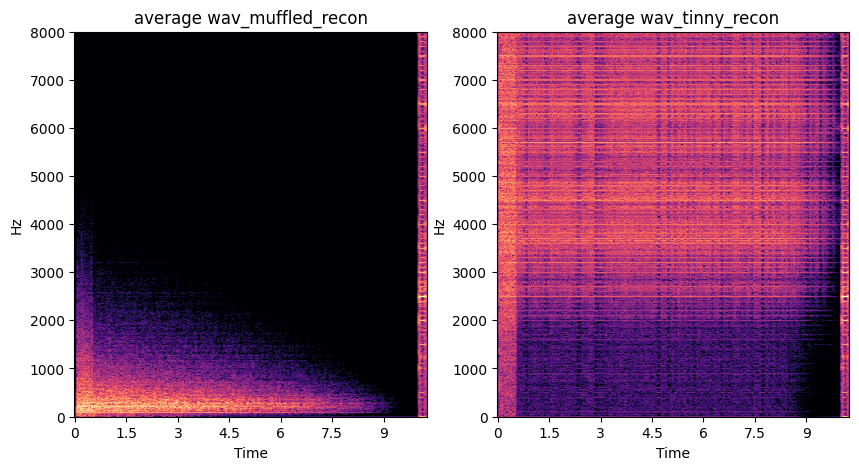

In [27]:
z_tinny = torch.from_numpy(np.mean(tinny_arr_10sec,axis=0)).cuda()
z_muffled = torch.from_numpy(np.mean(muffled_arr_10sec,axis=0)).cuda()

mel_muffled_recon = latent_diffusion.decode_first_stage(z_muffled)
wav_muffled_recon = latent_diffusion.mel_spectrogram_to_waveform(mel_muffled_recon, save=False)
IPython.display.display(IPython.display.Audio(wav_muffled_recon[0], rate=16000))


mel_tinny_recon = latent_diffusion.decode_first_stage(z_tinny)
wav_tinny_recon = latent_diffusion.mel_spectrogram_to_waveform(mel_tinny_recon, save=False)
IPython.display.display(IPython.display.Audio(wav_tinny_recon[0], rate=16000))

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
D = librosa.amplitude_to_db(np.abs(librosa.stft(wav_muffled_recon[0][0], hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
axs[0].set_title('average wav_muffled_recon')

D = librosa.amplitude_to_db(np.abs(librosa.stft(wav_tinny_recon[0][0], hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
axs[1].set_title('average wav_tinny_recon')

Text(0.5, 1.0, 'average wav_tinny_recon')

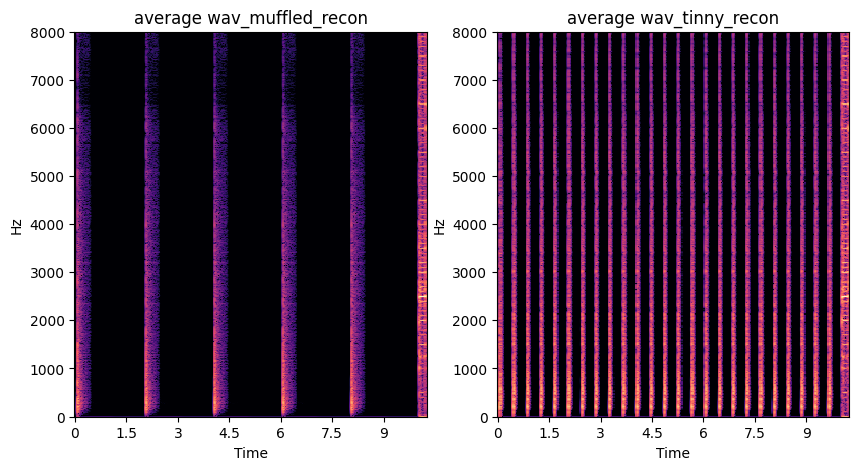

In [28]:
z_lowrate = torch.from_numpy(np.mean(lowrate_arr,axis=0)).cuda()
z_highrate = torch.from_numpy(np.mean(highrate_arr,axis=0)).cuda()

mel_lowrate_recon = latent_diffusion.decode_first_stage(z_lowrate)
wav_lowrate_recon = latent_diffusion.mel_spectrogram_to_waveform(mel_lowrate_recon, save=False)
IPython.display.display(IPython.display.Audio(wav_lowrate_recon[0], rate=16000))


mel_highrate_recon = latent_diffusion.decode_first_stage(z_highrate)
wav_highrate_recon = latent_diffusion.mel_spectrogram_to_waveform(mel_highrate_recon, save=False)
IPython.display.display(IPython.display.Audio(wav_highrate_recon[0], rate=16000))


fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
D = librosa.amplitude_to_db(np.abs(librosa.stft(wav_lowrate_recon[0][0], hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
axs[0].set_title('average wav_muffled_recon')

D = librosa.amplitude_to_db(np.abs(librosa.stft(wav_highrate_recon[0][0], hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
axs[1].set_title('average wav_tinny_recon')

Text(0.5, 1.0, 'recon')

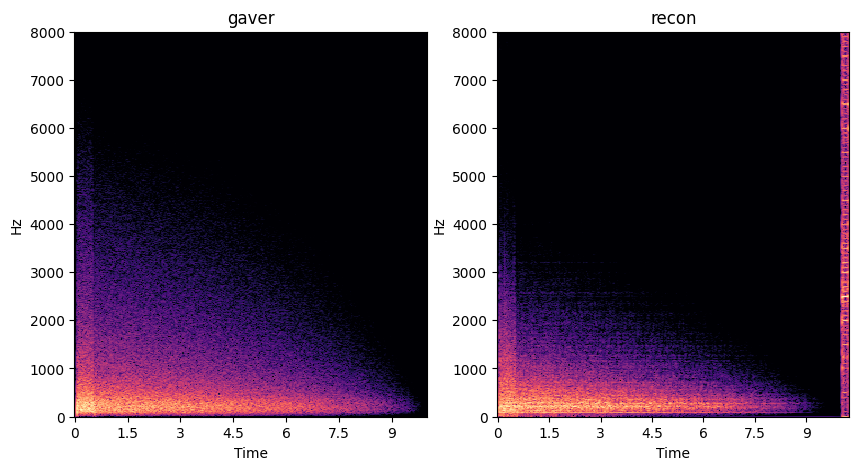

In [29]:
key = 'scratch_muffled_sample0_rate0'

wav = gaver_samples_dict_10sec[key]['audio']

z = get_z_from_audio_10sec(key)
recon = latent_diffusion.decode_first_stage(z)
recon = latent_diffusion.mel_spectrogram_to_waveform(recon, save=False)

IPython.display.display(IPython.display.Audio(wav, rate=16000))
IPython.display.display(IPython.display.Audio(recon[0], rate=16000))

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
D = librosa.amplitude_to_db(np.abs(librosa.stft(wav, hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
axs[0].set_title('gaver')

D = librosa.amplitude_to_db(np.abs(librosa.stft(recon[0][0], hop_length=512)),ref=np.max)
librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
axs[1].set_title('recon')

In [30]:
ddim_sampler = DDIMSampler(latent_diffusion, device=device)
ddim_sampler.make_schedule(ddim_num_steps=20, ddim_eta=1.0, verbose=False)

t = torch.from_numpy(np.array([15])).cuda()
with torch.no_grad():
    z_tinny_noised = ddim_sampler.stochastic_encode(z_tinny, t)
    z_muffled_noised = ddim_sampler.stochastic_encode(z_muffled, t)

    z_lowrate_noised = ddim_sampler.stochastic_encode(z_lowrate, t)
    z_highrate_noised = ddim_sampler.stochastic_encode(z_highrate, t)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.53it/s]


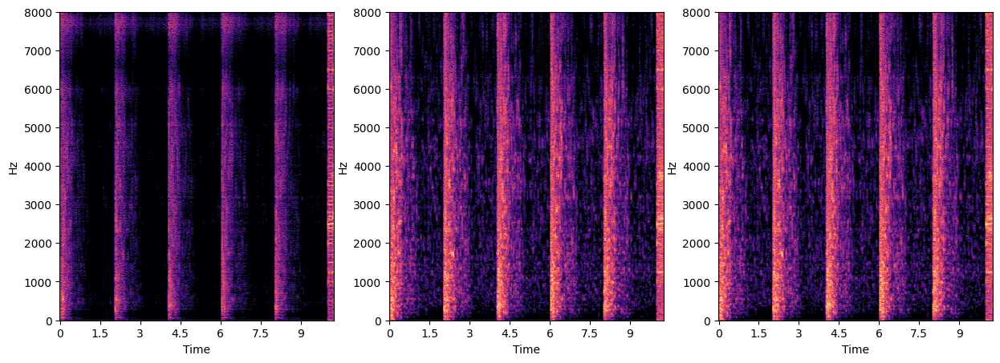

In [47]:
# text = "A drumstick is continuously hitting a metal surface"
# semantic_edit_text_left = "low number of impacts"
# semantic_edit_text_right = "high number of impacts"

batch = {
        "text": ["A drumstick is continuously hitting a metal surface"] * 1  # list
}

mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = sample_diffusion(batch, z_lowrate, random_seed=42)
plot(waveform1, model_cond1, model_cond1) 

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:03<00:00,  5.54it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.25it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]


num rows= 3


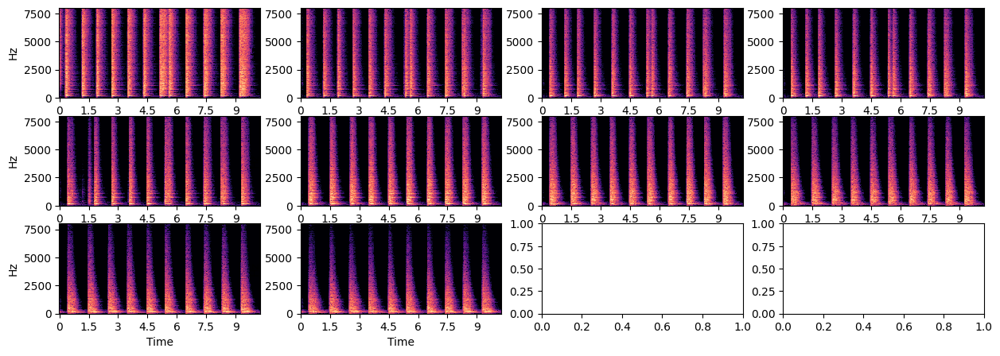

In [42]:
text = "A drumstick is continuously hitting a hard shiny metal surface in a large room."
semantic_edit_text_left = "An extremely dull or muffled sound with low frequency components"
semantic_edit_text_right = "An extremely bright sound with high frequency components"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [semantic_edit_text_left] * batch_size,
        "semantic_edit_text_right": [semantic_edit_text_right] * batch_size
}

x_example_left = z_muffled
x_example_right = z_tinny

wavs = []
semantic_guidance_levels = 8

for semantic_guidance_level in np.arange(0, semantic_guidance_levels, 0.8):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, semantic_guidance_level=-1*semantic_guidance_level, random_seed=43)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.38it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]


num rows= 1


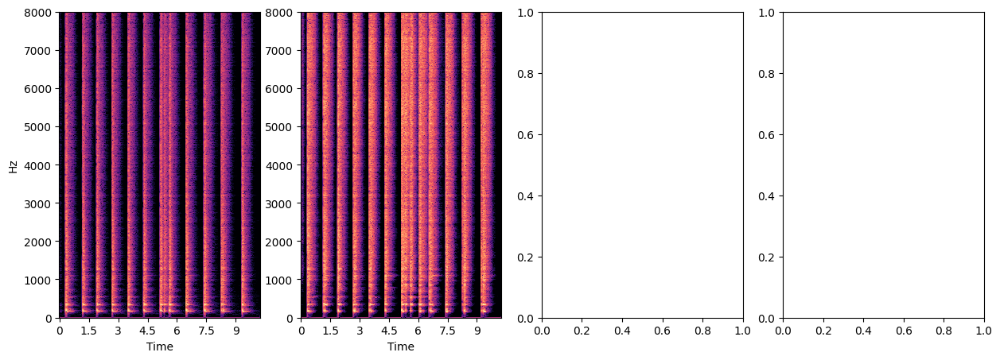

In [92]:
text = "A drumstick is continuously hitting a hard  surface in a large room."
semantic_edit_text_left = "An extremely dull or muffled sound with low frequency components"
semantic_edit_text_right = "An extremely bright sound with high frequency components"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [semantic_edit_text_left] * batch_size,
        "semantic_edit_text_right": [semantic_edit_text_right] * batch_size
}

x_example_left = z_muffled_noised
x_example_right = z_tinny_noised

wavs = []
semantic_guidance_levels = 8

for semantic_guidance_level in np.arange(0, 21, 20):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, semantic_guidance_level=1*semantic_guidance_level, random_seed=43)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.09it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]


num rows= 1


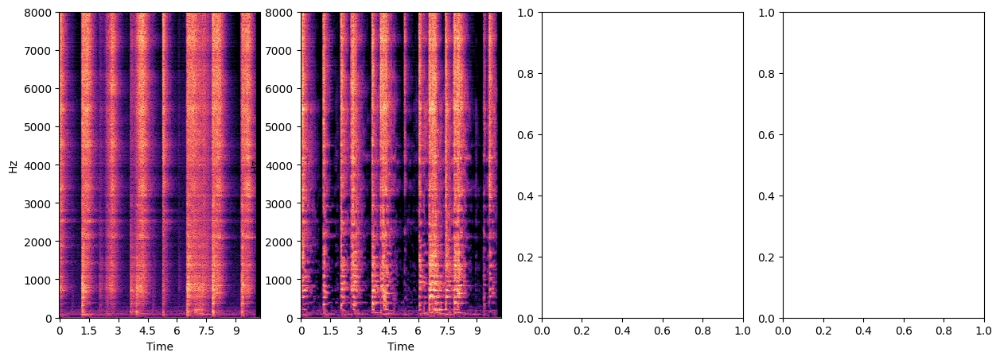

In [49]:
text = "A drumstick is continuously hitting a metal surface"
semantic_edit_text_left = "low number of impacts"
semantic_edit_text_right = "high number of impacts"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [text] * batch_size,
        "semantic_edit_text_right": [text] * batch_size
}

x_example_left = z_lowrate
x_example_right = z_highrate

wavs = []
semantic_guidance_levels = 10

for semantic_guidance_level in np.arange(0, 10, 1):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, semantic_guidance_level=-1*semantic_guidance_level, random_seed=42)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.08it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]


num rows= 1


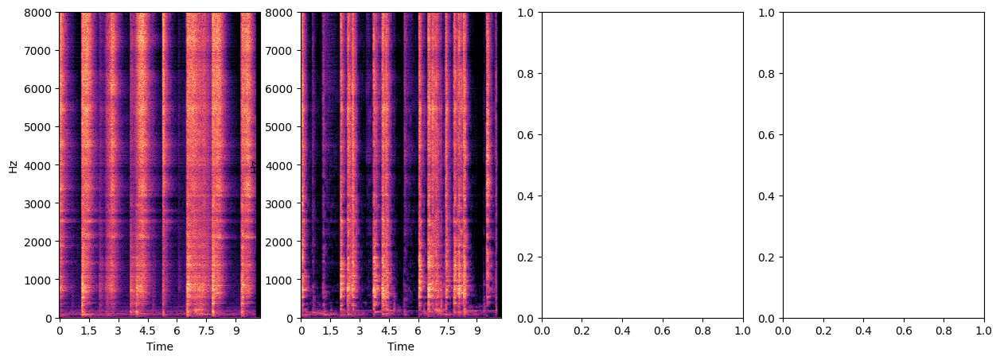

In [105]:
text = "A drumstick is continuously hitting a metal surface"
semantic_edit_text_left = "low number of impacts"
semantic_edit_text_right = "high number of impacts"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [semantic_edit_text_left] * batch_size,
        "semantic_edit_text_right": [semantic_edit_text_right] * batch_size
}

x_example_left = z_lowrate_noised
x_example_right = z_highrate_noised

wavs = []
semantic_guidance_levels = 10

for semantic_guidance_level in np.arange(0, 0.2, 0.1):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, \
                                                  semantic_guidance_level=-1*semantic_guidance_level, random_seed=42)
    wavs.append(waveform1)

plot_all(wavs)

word ids => [0, 1, 2, 3, 4, 4, None]
Token for each word in sentence => [[0], [1], [2], [3], [4, 5]] torch.Size([7])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.57it/s]


word ids => [0, 1, 2, 3, 4, 4, None]
Token for each word in sentence => [[0], [1], [2], [3], [4, 5]] torch.Size([7])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.39it/s]


word ids => [0, 1, 2, 3, 4, 4, None]
Token for each word in sentence => [[0], [1], [2], [3], [4, 5]] torch.Size([7])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]


word ids => [0, 1, 2, 3, 4, 4, None]
Token for each word in sentence => [[0], [1], [2], [3], [4, 5]] torch.Size([7])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.37it/s]


word ids => [0, 1, 2, 3, 4, 4, None]
Token for each word in sentence => [[0], [1], [2], [3], [4, 5]] torch.Size([7])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
word ids => [0, 1, 2, 3, None]
Token for each word in sentence => [[0], [1], [2], [3]] torch.Size([5])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]


num rows= 2


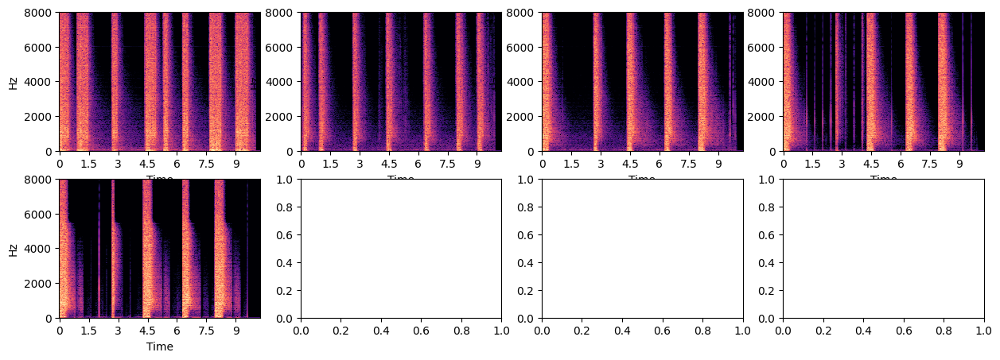

In [31]:
text = "A machine gun rapidly firing"
semantic_edit_text_left = "low number of impacts"
semantic_edit_text_right = "high number of impacts"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [semantic_edit_text_left] * batch_size,
        "semantic_edit_text_right": [semantic_edit_text_right] * batch_size
}

x_example_left = z_lowrate
x_example_right = z_highrate

wavs = []
semantic_guidance_levels = 10

for semantic_guidance_level in np.arange(0, semantic_guidance_levels, 2):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, \
                                                  semantic_guidance_level=-1*semantic_guidance_level, random_seed=47)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.67it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]


num rows= 1


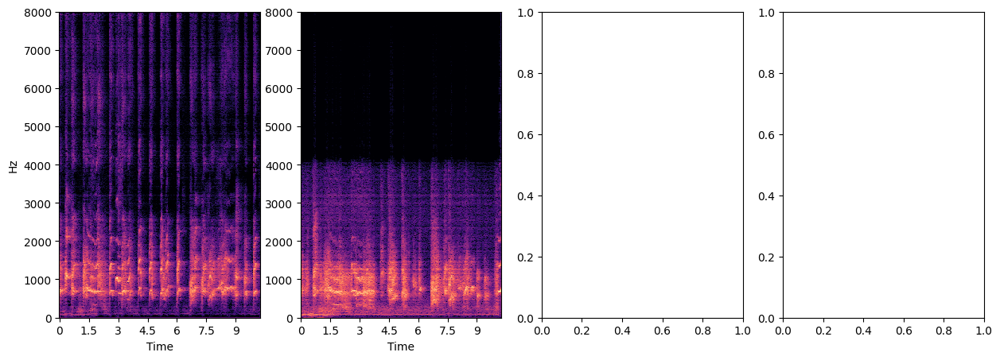

In [54]:
text = "Continuous high pitched barking of a small dog in a garden."
semantic_edit_text_left = "An extremely dull or muffled sound with low frequency components"
semantic_edit_text_right = "An extremely bright sound with high frequency components"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [text] * batch_size,
        "semantic_edit_text_right": [text] * batch_size
}

x_example_left = z_muffled
x_example_right = z_tinny

wavs = []
semantic_guidance_levels = 1

for semantic_guidance_level in np.arange(0, 3, 2):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, \
                                                  semantic_guidance_level=-1*semantic_guidance_level, random_seed=41)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.45it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]


num rows= 1


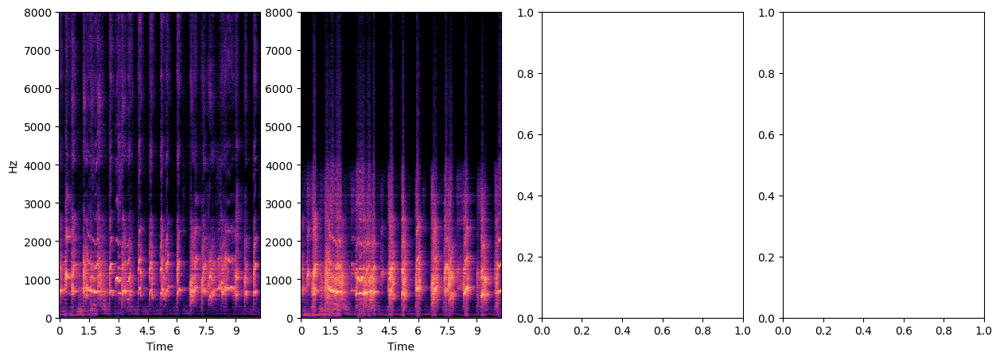

In [57]:
text = "Continuous high pitched barking of a small dog in a garden."
semantic_edit_text_left = "An extremely dull or muffled sound with low frequency components"
semantic_edit_text_right = "An extremely bright sound with high frequency components"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [text] * batch_size,
        "semantic_edit_text_right": [text] * batch_size
}

x_example_left = get_z_from_audio('scratch_tinny_sample0_rate0')
x_example_right = get_z_from_audio('scratch_muffled_sample0_rate0')

wavs = []
semantic_guidance_levels = 1

for semantic_guidance_level in np.arange(0, 3, 2):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, \
                                                  semantic_guidance_level=1*semantic_guidance_level, random_seed=41)
    wavs.append(waveform1)

plot_all(wavs)

Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.24it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]


Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]


num rows= 1


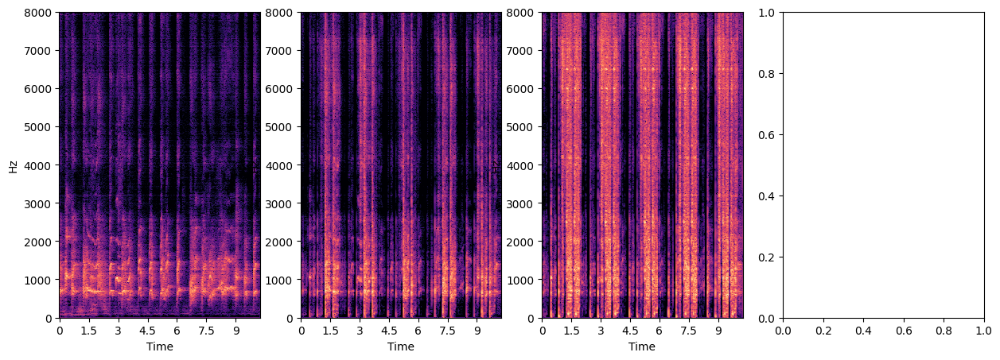

In [50]:
text = "Continuous high pitched barking of a small dog in a garden."
semantic_edit_text_left = "sound with low number of events"
semantic_edit_text_right = "sound with high number of events"

batch = {
        "text": [text] * batch_size,  # list
        "semantic_edit_text_left": [semantic_edit_text_left] * batch_size,
        "semantic_edit_text_right": [semantic_edit_text_right] * batch_size
}

x_example_left = z_lowrate
x_example_right = z_highrate

wavs = []
semantic_guidance_levels = 3

for semantic_guidance_level in np.arange(0, semantic_guidance_levels, 1):
    mel1, waveform1, model_cond1, model_uncond1, e_t_semedit1, intermediates1 = \
    sample_diffusion_with_exampleguidance_diffvec(batch, x_init, x_example_left, x_example_right, semantic_guidance_level=1*semantic_guidance_level, random_seed=41)
    wavs.append(waveform1)

plot_all(wavs)